### Laboratorio 1 Óptica de Fourier: Filtrado espacial analógico y digital

Intergrantes:
- María José Gil
- Santiago Pascuas
- Jacobo Chica Quintero


En este proyecto se realizaron los filtrados espaciales correspondientes al laboratorio 1 de óptica de Fourier, replicando los datos obtenidos analogicamente y realizando actividades digitales como la eliminación de filtro Speckel o filtrado de frecuencias para un patrón especifico.

##### Se importan las librerias

In [1]:
import numpy as np
import cv2
import plotly.express as px
import matplotlib.pyplot as plt
from numpy.fft import ifft2, fft2, fftshift, ifftshift

### Parte III: Realizar procesamiento de imagenes mediante operaciones de filtrado espacial digitalmente para:
- Eliminación de ruido de una imagen
- Extraer selectivamente información de una imagen

##### A. Remueva el ruido Gaussiano de la imagen de Lenna y obtenga una mejor imagen

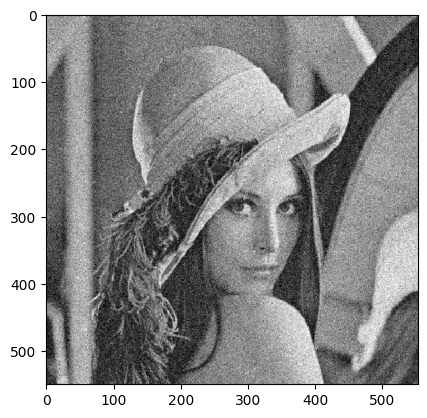

In [2]:
# Se carga la imagen de Lenna con ruido Gaussiano
Lenna_img = cv2.imread(f'Lenna.png', cv2.IMREAD_GRAYSCALE)

# Se agraga el tamaño de la imagen donde cada pixel tiene una posicón fila (m), columna (n).
m, n = Lenna_img.shape

# Se convierte la imagen en una matriz
Lenna_img = np.array(Lenna_img)

# Se grafica la imagen con ruido Gaussiano
plt.imshow(Lenna_img, cmap = "gray")

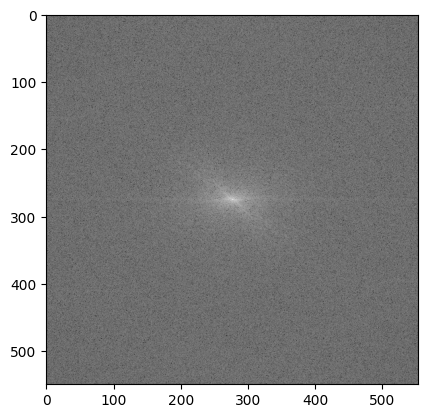

In [3]:
# Se obtiene la transformada de Fourier de la imagen de Lenna
Lenna_fourier = ifftshift(fft2(fftshift(Lenna_img)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(Lenna_fourier)), cmap = "gray")

In [4]:
# Se crea la mascara del filtrado espacial generando una matriz 2D de ceros del tamaño de la imagen de Lenna
Lenna_mask = np.zeros((m, n))

# Se llena la matriz con el circulo de radio 100
for i in range (200):
  for j in range(200):
    if np.sqrt(i**2 + j**2)<100:
      Lenna_mask[i+(Lenna_mask.shape[0] // 2), j + (Lenna_mask.shape[1] // 2)] = 1
      Lenna_mask[i+(Lenna_mask.shape[0] // 2), (Lenna_mask.shape[1] // 2)-j] = 1
      Lenna_mask[(Lenna_mask.shape[0] // 2)-i, j + (Lenna_mask.shape[1] // 2)] = 1
      Lenna_mask[(Lenna_mask.shape[0] // 2)-i, (Lenna_mask.shape[1] // 2)-j] = 1

# Se crea la figura de la mascara y se grafica
Lenna_mask_fig= px.imshow(Lenna_mask, color_continuous_scale='gray')
Lenna_mask_fig.show()

In [5]:
# Se pasa el filtro espacial a la transofrmada de Fourier de Lenna y se grafica
Lenna_fourier_filtro = Lenna_fourier*Lenna_mask
# plt.imshow(np.abs(np.log(Lenna_fourier_filtro)), cmap = "gray")

In [6]:
# Se obtiene la antitransofrmada de Fourier de la imagen de Lenna con el filtrado espacial
Lenna_final = ifftshift(ifft2(fftshift(Lenna_fourier_filtro)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
Lenna_final = np.abs(Lenna_final)

# Se crea una lista de las dos imagenes a graficar
images = np.array([Lenna_final, Lenna_img])

# Se grafica la imagen de Lenna con la correccion de ruido y despues la imagen original
fig = px.imshow(images, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro espacial paso bajo para eliminar el ruido Gaussiano presente en la imagen de la derecha.

##### B. Remueva los puntos negros de fondo de la imagen tipografica de los periodicos usando un filtro espacial

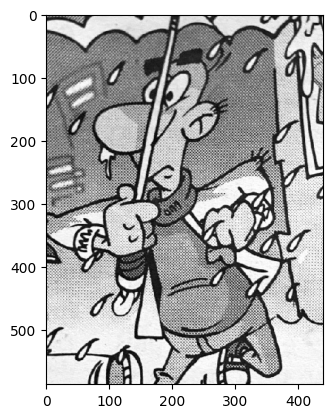

In [7]:
# Se carga la imagen de la tipografia
period_img = cv2.imread(f'Periodico.png', cv2.IMREAD_GRAYSCALE)

# Se agraga el tamaño de la imagen donde cada pixel tiene una posicón fila (m1), columna (n1).
m1, n1 = period_img.shape

# Se convierte la imagen en una matriz
period_img = np.array(period_img)

# Se grafica la imagen con los puntos negros
plt.imshow(period_img, cmap = "gray")

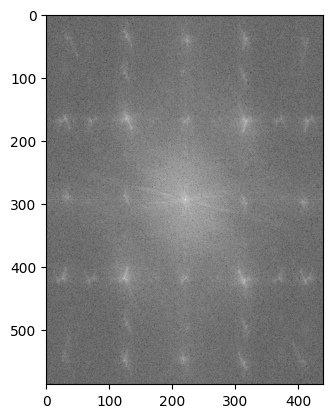

In [8]:
# Se obtiene la transformada de Fourier de la imagen de la tipografia
period_fourier = ifftshift(fft2(fftshift(period_img)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(period_fourier)), cmap = "gray")

In [9]:
# Se crea la mascara del filtrado espacial generando una matriz 2D de ceros del tamaño de la imagen de la litografia
period_mask = np.zeros((m1, n1))

# Se llena la matriz con el circulo de radio 75
for i in range (200):
  for j in range(200):
    if np.sqrt(i**2 + j**2)<75:
      period_mask[i+(period_mask.shape[0] // 2), j + (period_mask.shape[1] // 2)] = 1
      period_mask[i+(period_mask.shape[0] // 2), (period_mask.shape[1] // 2)-j] = 1
      period_mask[(period_mask.shape[0] // 2)-i, j + (period_mask.shape[1] // 2)] = 1
      period_mask[(period_mask.shape[0] // 2)-i, (period_mask.shape[1] // 2)-j] = 1

# Se crea la figura de la mascara y se grafica
period_mask_fig= px.imshow(period_mask, color_continuous_scale='gray')
# period_mask_fig.show()


<ipython-input-10-3fbbf9635fd1>:3: RuntimeWarning:

divide by zero encountered in log



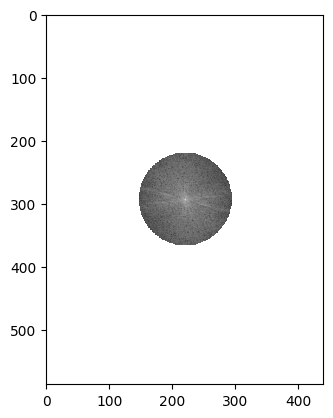

In [10]:
# Se pasa el filtro espacial a la transofrmada de Fourier de la litografia y se grafica
period_fourier_filtro = period_fourier*period_mask
plt.imshow(np.abs(np.log(period_fourier_filtro)), cmap = "gray")

In [11]:
# Se obtiene la antitransofrmada de Fourier de la imagen de la litografia con el filtrado espacial
period_final = ifftshift(ifft2(fftshift(period_fourier_filtro)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
period_final = np.abs(period_final)

# Se crea una lista de las dos imagenes a graficar
images1 = np.array([period_final, period_img])

# Se grafica la imagen de Lenna con la correccion de ruido y despues la imagen original
fig = px.imshow(images1, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro espacial paso bajo para eliminar los puntos negros de fondo presente en la imagen de la derecha.

##### C. Remueva laa palabra "CALDAS" de la imagen del billete de 20 pesos de 1983 usando un filtro espacial

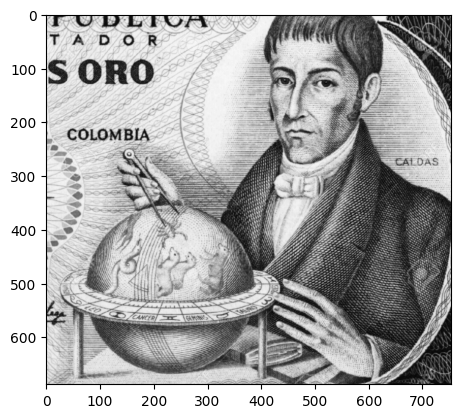

In [12]:
# Se carga la imagen del billete con CALDAS
caldas_img = cv2.imread(f'Caldas.png', cv2.IMREAD_GRAYSCALE)

# Se agraga el tamaño de la imagen donde cada pixel tiene una posicón fila (m1), columna (n1).
m2, n2 = caldas_img.shape

# Se convierte la imagen en una matriz
caldas_img = np.array(caldas_img)

# Se grafica la imagen completa
plt.imshow(caldas_img, cmap = "gray")

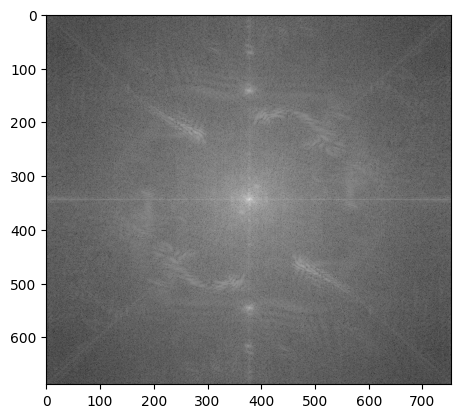

In [13]:
# Se obtiene la transformada de Fourier de la imagen del billete
caldas_fourier = ifftshift(fft2(fftshift(caldas_img)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(caldas_fourier)), cmap = "gray")

In [14]:
# Se realiza una mascara para obtener unicamente la información de la parte de CALDAS
caldas_mask = np.zeros((caldas_img.shape))

# Se llena de 1 los pixeles que forman Caldas
caldas_mask[265:285, 645:730] = 1

# Se realiza el filtro de la imagen completa con las mascara de la posicion de caldas
caldas_filt = caldas_img*caldas_mask

caldas_filt_fig= px.imshow(caldas_filt, color_continuous_scale='gray')
caldas_filt_fig.show()

In [15]:
# Ahora se realiza un filtro que binarice la imagen para cambiar las intensidades de los colores
for i in range(265,285):
    for j in range(645,730):
        if caldas_filt[i,j] <= 150:
            caldas_filt[i,j] = 300
        else:
            caldas_filt[i,j] = 0


caldas_filt_fig1= px.imshow(caldas_filt, color_continuous_scale='gray')
caldas_filt_fig1.show()

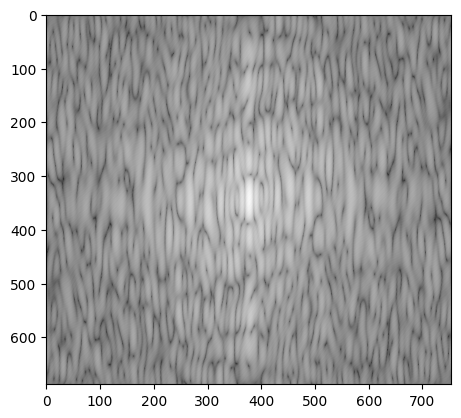

In [16]:
# Obtenemos la Transformada de Fourier del filtro binario
caldas_filt_fourier = ifftshift(fft2(fftshift(caldas_filt)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(caldas_filt_fourier)), cmap = "gray")

In [17]:
# Ahora se realiza la resta de las transformadas de Fourier para eliminar las frecuencias de la palabra Caldas
billete_caldas_fourier = caldas_fourier - caldas_filt_fourier

# Se realiza la antitransformada para obtener la imagen nueva
billete_caldas = ifftshift(ifft2(fftshift(billete_caldas_fourier)))


# Se saca el valor absoluto de la antitransformada para poder se graficada
billete_caldas = np.abs(billete_caldas)

# Se crea una lista de las dos imagenes a graficar
images2 = np.array([billete_caldas, caldas_img])

# Se grafica la imagen de Lenna con la correccion de ruido y despues la imagen original
fig = px.imshow(images2, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro que binarice la palabra Caldas en la imagen de la derecha.

##### D. Remueva las lineas verticales y horizontales de la xilografia aplicando filtros espaciales

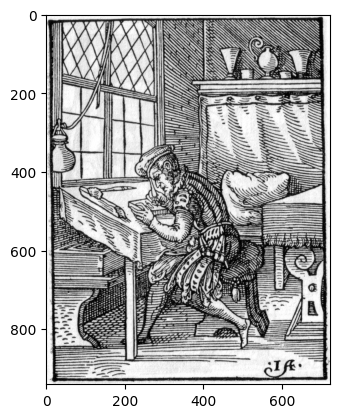

In [18]:
# Se agrega la imagen de la xilografia
xilo_img = cv2.imread(f'Xilografia.jpeg', cv2.IMREAD_GRAYSCALE)

xilo_img = np.array(xilo_img)

# Se obtiene sus medidas y se grafica
m5, n5 = xilo_img.shape
plt.imshow(xilo_img, cmap = "gray")

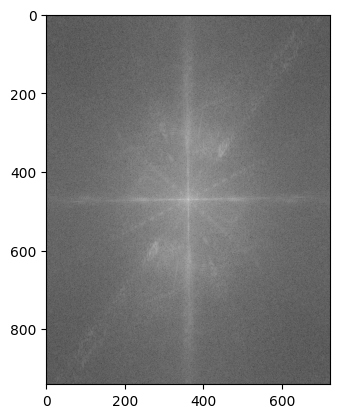

In [19]:
# Se obtiene la transformada de Fourier de la xilografia
xilo_fourier = ifftshift(fft2(fftshift(xilo_img)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(xilo_fourier)), cmap = "gray")

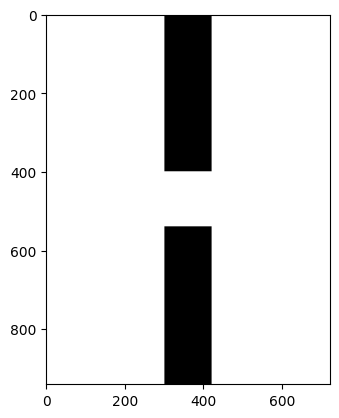

In [20]:
# Se crea una matriz de unos del tamaño de la imagen de la xilografia
xilo_mask_hor = np.ones((m5,n5))

# Se crea la mascara vertical y se grafica
xilo_mask_hor[:, n5//2-60:n5//2+60] = 0
xilo_mask_hor[m5//2-70:m5//2+70, :] = 1
plt.imshow(xilo_mask_hor, cmap = "gray")

<ipython-input-21-ed96e72c172c>:3: RuntimeWarning:

divide by zero encountered in log



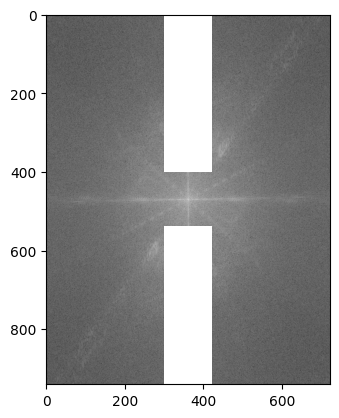

In [21]:
# Se pasa el filtro espacial a la transofrmada de Fourier de la xilografia y se grafica
xilo_filt_fourier_hor = xilo_fourier*xilo_mask_hor
plt.imshow(np.abs(np.log(xilo_filt_fourier_hor)), cmap = "gray")

In [22]:
# Se obtiene la antitransofrmada de Fourier de la imagen de la xilografia con el filtrado espacial
xilo_hor = ifftshift(ifft2(fftshift(xilo_filt_fourier_hor)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
xilo_hor = np.abs(xilo_hor)


# Se crea una lista de las dos imagenes a graficar
images1 = np.array([xilo_hor, xilo_img])

# Se grafica la imagen de las xilografias filtrando las lineas horizontales y despues la imagen original
fig = px.imshow(images1, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro vertical que impida el paso de las frecuencias horizontales  de la imagen de la derecha.

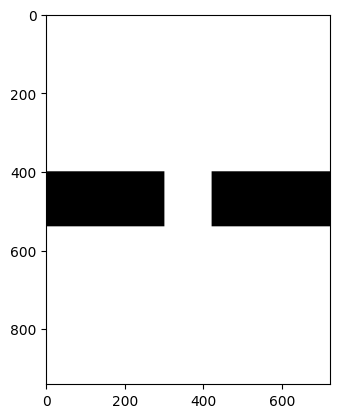

In [23]:
# Se crea una matriz de unos del tamaño de la imagen de la xilografia
xilo_mask_ver = np.ones((m5,n5))

# Se crea la mascara vertical y se grafica
xilo_mask_ver[m5//2-70:m5//2+70, :] = 0
xilo_mask_ver[:, n5//2-60:n5//2+60] = 1
plt.imshow(xilo_mask_ver, cmap = "gray")

<ipython-input-24-e2295e8d9a71>:3: RuntimeWarning:

divide by zero encountered in log



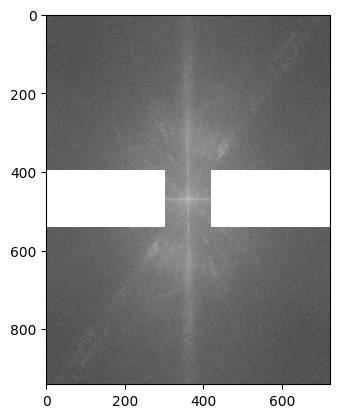

In [24]:
# Se pasa el filtro espacial a la transofrmada de Fourier de la xilografia y se grafica
xilo_filt_fourier_ver = xilo_fourier*xilo_mask_ver
plt.imshow(np.abs(np.log(xilo_filt_fourier_ver)), cmap = "gray")

In [25]:
# Se obtiene la antitransofrmada de Fourier de la imagen de la xilografia con el filtrado espacial
xilo_ver = ifftshift(ifft2(fftshift(xilo_filt_fourier_ver)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
xilo_ver = np.abs(xilo_ver)


# Se crea una lista de las dos imagenes a graficar
images1 = np.array([xilo_ver, xilo_img])

# Se grafica la imagen de las xilografias filtrando las lineas horizontales y despues la imagen original
fig = px.imshow(images1, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro horizontal que impida el paso de las frecuencias verticales  de la imagen de la derecha.

##### E. Con un mapa de Colombia, cuyas regiones poseen distintos patrones, se busca hallar las frecuencias correspondientes a cada una y poder seleccionar diferentes regiones

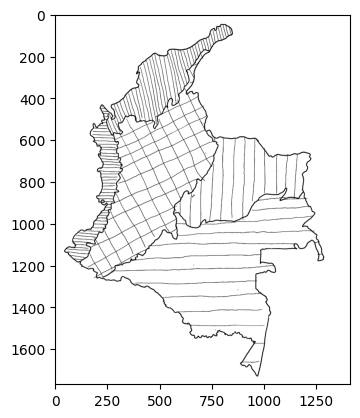

In [26]:
# Se agrega la imagen del mapa creada por nosotros
mapa_img = cv2.imread(f'mapa_reg.png', cv2.IMREAD_GRAYSCALE)

mapa_img = np.array(mapa_img)

# Se obtiene sus medidas y se grafica
m3, n3 = mapa_img.shape
plt.imshow(mapa_img, cmap = "gray")

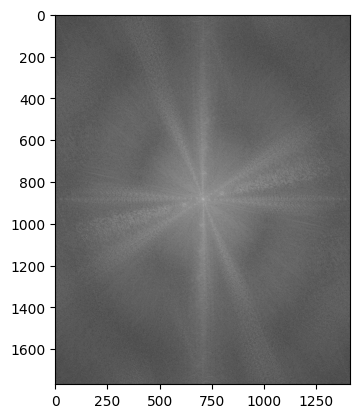

In [27]:
# Se obtiene la transformada de Fourier del mapa
mapa_fourier = ifftshift(fft2(fftshift(mapa_img)))

# Se grafica la transofrmada de fourier
plt.imshow(np.abs(np.log(mapa_fourier)), cmap = "gray")

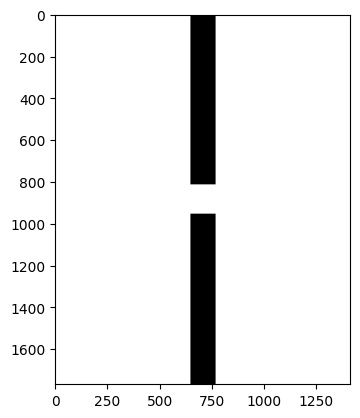

In [28]:
# Se crea una matriz de unos del tamaño de la imagen del mapa
mapa_mask_hor = np.ones((m3,n3))

# Se crea la mascara vertical y se grafica
mapa_mask_hor[:, n3//2-60:n3//2+60] = 0
mapa_mask_hor[m3//2-70:m3//2+70, :] = 1
plt.imshow(mapa_mask_hor, cmap = "gray")

<ipython-input-29-e4a51049a1ba>:3: RuntimeWarning:

divide by zero encountered in log



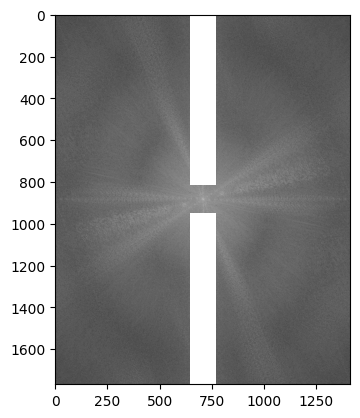

In [29]:
# Se pasa el filtro espacial a la transofrmada de Fourier del mapa y se grafica
mapa_filt_fourier_hor = mapa_fourier*mapa_mask_hor
plt.imshow(np.abs(np.log(mapa_filt_fourier_hor)), cmap = "gray")

In [30]:
# Se obtiene la antitransofrmada de Fourier de la imagen del mapa con el filtrado espacial
mapa_hor = ifftshift(ifft2(fftshift(mapa_filt_fourier_hor)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
mapa_hor = np.abs(mapa_hor)


# Se crea una lista de las dos imagenes a graficar
images1 = np.array([mapa_hor, mapa_img])

# Se grafica la imagen del mapa cortando las lineas horizontales y despues la imagen original
fig = px.imshow(images1, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro vertical que impida el paso de las frecuencias horizontales  de la imagen de la derecha.

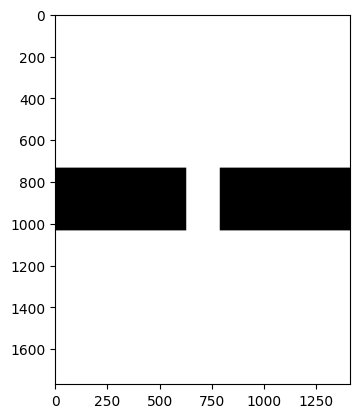

In [31]:
# Se crea una matriz de unos del tamaño de la imagen del mapa
mapa_mask_ver = np.ones((m3,n3))

# Se crea la mascara horizontal y se grafico
mapa_mask_ver[m3//2-150:m3//2+150, :] = 0
mapa_mask_ver[:, n3//2-80:n3//2+80] = 1
plt.imshow(mapa_mask_ver, cmap = "gray")

<ipython-input-32-14752c97e458>:3: RuntimeWarning:

divide by zero encountered in log



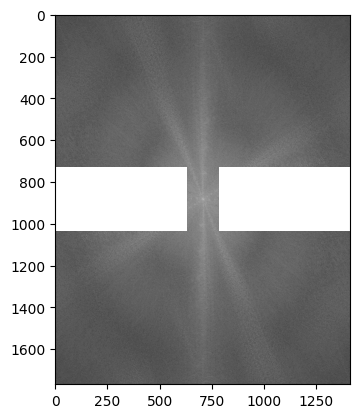

In [32]:
# Se pasa el filtro espacial a la transofrmada de Fourier del mapa y se grafica
mapa_filt_fourier_ver = mapa_fourier*mapa_mask_ver
plt.imshow(np.abs(np.log(mapa_filt_fourier_ver)), cmap = "gray")

In [33]:
# Se obtiene la antitransofrmada de Fourier de la imagen de la litografia con el filtrado espacial
mapa_ver = ifftshift(ifft2(fftshift(mapa_filt_fourier_ver)))

# Se saca el valor absoluto de la antitransformada para poder se graficada
mapa_ver = np.abs(mapa_ver)


# Se crea una lista de las dos imagenes a graficar
images1 = np.array([mapa_ver, mapa_img])

# Se grafica la imagen de Colombia
fig = px.imshow(images1, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()

### Rta/
La imagen de la izquierda es el resultado de aplicar un filtro horizontal que impida el paso de las frecuencias verticales  de la imagen de la derecha.

F. Maximiliano: se le aplican los diferentes filtro

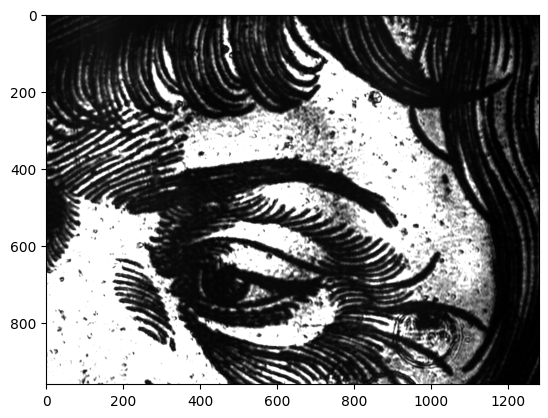

In [35]:
# se agrega la imagen de Maximiliano de la zona vista en el laboratorio
image = cv2.imread('Maxi.png', cv2.IMREAD_GRAYSCALE)

# se saca las medidas de la imagen
m, n = image.shape
image = np.array(image)

# se plotea la imagen
plt.imshow(image, cmap = "gray")

In [41]:
# se genera la mascara circular para simular los obstaculos (si se desea probar con ese tipo)
mask_circular = np.ones((m, n))  # Se genera una matriz 2D de ceros que se va a convertir en el circulo

for i in range (200): # Se llena la matriz con el circulo de radio 20 (Pitagorazo)
  for j in range(200):
    if np.sqrt(i**2 + j**2)<15:
      mask_circular[i+(mask_circular.shape[0] // 2), j + (mask_circular.shape[1] // 2)] = 0
      mask_circular[i+(mask_circular.shape[0] // 2), (mask_circular.shape[1] // 2)-j] = 0
      mask_circular[(mask_circular.shape[0] // 2)-i, j + (mask_circular.shape[1] // 2)] = 0
      mask_circular[(mask_circular.shape[0] // 2)-i, (mask_circular.shape[1] // 2)-j] = 0
fig= px.imshow(mask_circular, color_continuous_scale='gray')
fig.show()

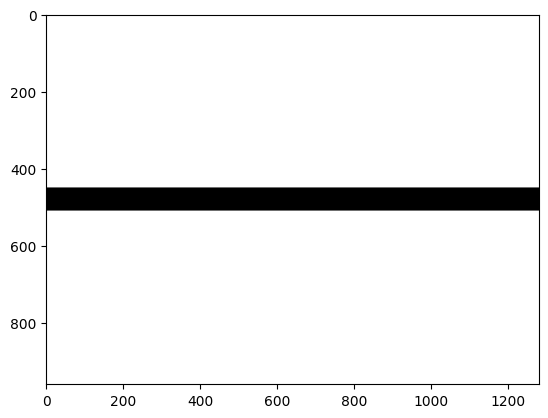

In [42]:
# se crean las diferentes mascaras, dependiendo de si se quiere simular una rendiga o franja opaca se descomenta o comenta la deseada
mask = np.ones((m,n))

mask[m//2-30:m//2+30,:] = 0  # Mascara linea opaca horizontal
# mask[:,n//2-30:n//2+30] = 0  # Mascara linea opaca vertical
# mask[m//2-30:m//2+30,:] = 1  # Mascara rendija horizontal
# mask[:,n//2-30:n//2+30] = 1  # Mascara rendija vertical

plt.imshow(mask, cmap = "gray")

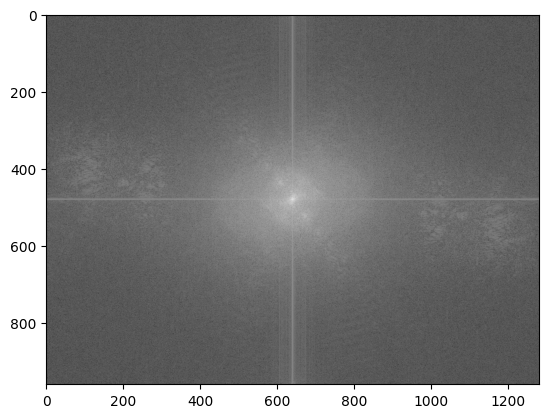

In [37]:
# se le saca la transformada de fourier a la imagen
fourier_image = ifftshift(fft2(fftshift(image)))
plt.imshow(np.abs(np.log(fourier_image)), cmap = "gray")

<ipython-input-39-332623538da0>:3: RuntimeWarning:

divide by zero encountered in log



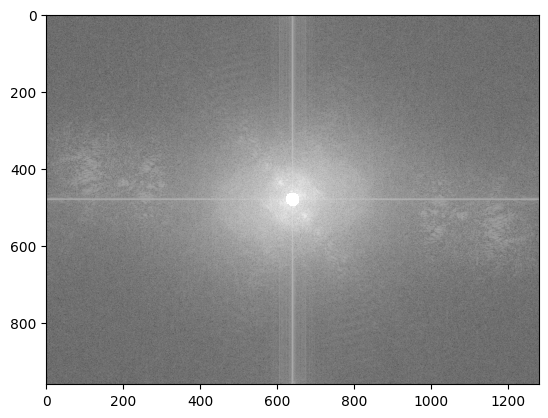

In [39]:
# Se pasa el filtro espacial a la transofrmada de Fourier de la imagen
filt = fourier_image*mask_circular
plt.imshow(np.abs(np.log(filt)), cmap = "gray")

In [40]:
# se le saca la antitransformada
final = ifftshift(ifft2(fftshift(filt)))

# se le saca el valor absoluto a la antitransformada
final = np.abs(final)

# se crea una lista con las dos imagenes
images = np.array([final, image])

# se grafica la imagen resultante
fig = px.imshow(images, facet_col=0, binary_string=True, facet_col_wrap=2, labels={'facet_col':'image'})
fig.show()